<a href="https://colab.research.google.com/github/Rajesh2607/image-and-video-generation/blob/main/image_and_video_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from diffusers import StableDiffusionPipeline
import torch

# Load the pre-trained model from HuggingFace
model_id = "CompVis/stable-diffusion-v1-4"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.to("cuda")  # Use GPU for faster processing

# Define your prompt
prompt = input()

# Generate an image
image = pipe(prompt).images[0]

# Save the generated image
output_path = "generated_image.png"
image.save(output_path)

print(f"Image saved at {output_path}")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

indian flag


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at generated_image.png


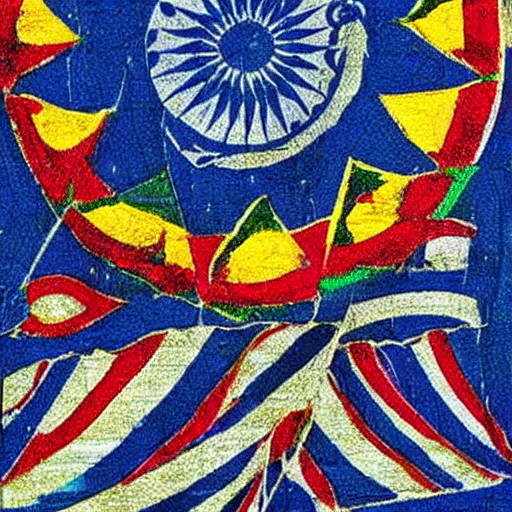

In [ ]:
from IPython.display import display

display(image)


In [ ]:
!pip install torch torchvision torchaudio diffusers transformers accelerate opencv-python numpy



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 50.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 30.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 33.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import torch
import cv2
import numpy as np
from diffusers import StableDiffusionPipeline
from PIL import Image

# Load Stable Diffusion model
model_id = "CompVis/stable-diffusion-v1-4"
device = "cuda" if torch.cuda.is_available() else "cpu"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16 if device == "cuda" else torch.float32)
pipe.to(device)

# Video settings
num_frames = 30  # Total frames
fps = 10  # Frames per second
video_filename = "generated_video.avi"  # Change to .mp4 if needed
frame_size = (512, 512)  # Image size

# Define text prompts
base_prompts = [
    "A futuristic cityscape at night with neon lights",
    "A cyberpunk street with flying cars and glowing billboards",
    "A sci-fi metropolis with rain and reflections",
    "A digital dream world with glowing holograms",
]
prompts = base_prompts * ((num_frames // len(base_prompts)) + 1)
prompts = prompts[:num_frames]  # Ensure correct number of frames

# Initialize OpenCV VideoWriter
fourcc = cv2.VideoWriter_fourcc(*"XVID")  # Use XVID for AVI, MP4V for MP4
video_writer = cv2.VideoWriter(video_filename, fourcc, fps, frame_size)

print("Generating video frames...")

for i, prompt in enumerate(prompts):
    print(f"Generating frame {i+1}/{num_frames} - {prompt}")

    # Generate image
    image = pipe(prompt).images[0]

    # Convert image to OpenCV format
    image = np.array(image)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)  # Convert RGB to BGR for OpenCV
    image = cv2.resize(image, frame_size)  # Resize to match video frame size

    # Write frame to video
    video_writer.write(image)

# Release video writer
video_writer.release()
print(f"Video saved as {video_filename}")

# Display video in Jupyter Notebook
try:
    from IPython.display import Video, display
    display(Video(video_filename, embed=True))
except ImportError:
    print("Video generated. Open manually to view.")


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Generating video frames...
Generating frame 1/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 2/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 3/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 4/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 5/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 6/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 7/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 8/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 9/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 10/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 11/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 12/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 13/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 14/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 15/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 16/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 17/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 18/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 19/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 20/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 21/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 22/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 23/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 24/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 25/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 26/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 27/30 - A sci-fi metropolis with rain and reflections


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 28/30 - A digital dream world with glowing holograms


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 29/30 - A futuristic cityscape at night with neon lights


  0%|          | 0/50 [00:00<?, ?it/s]

Generating frame 30/30 - A cyberpunk street with flying cars and glowing billboards


  0%|          | 0/50 [00:00<?, ?it/s]

Video saved as generated_video.avi


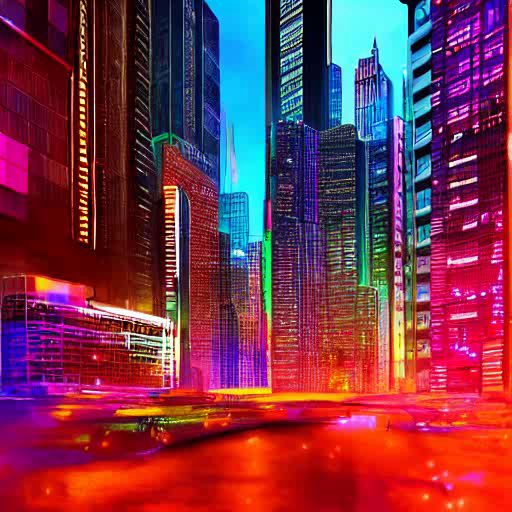

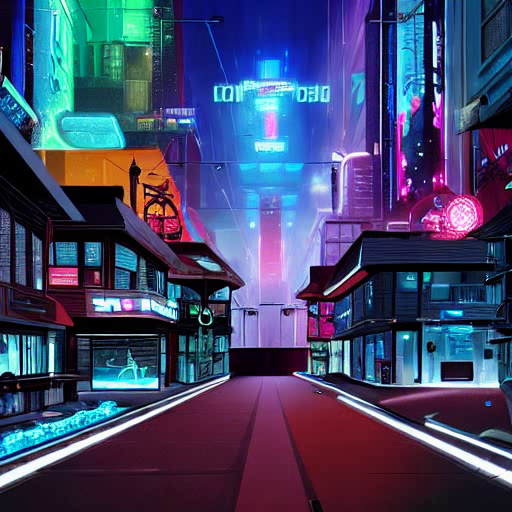

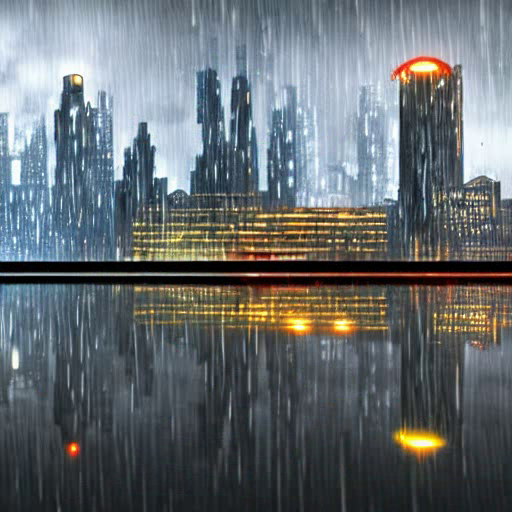

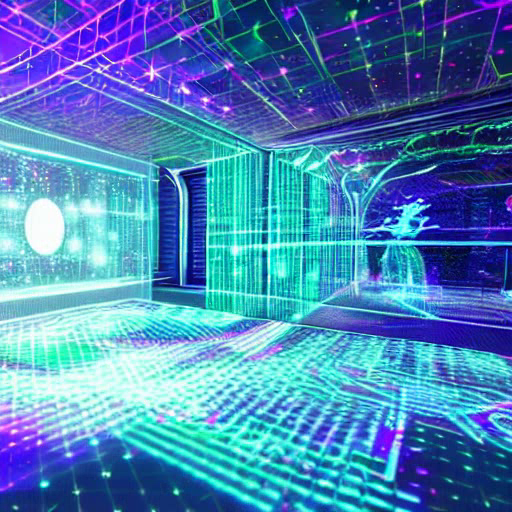

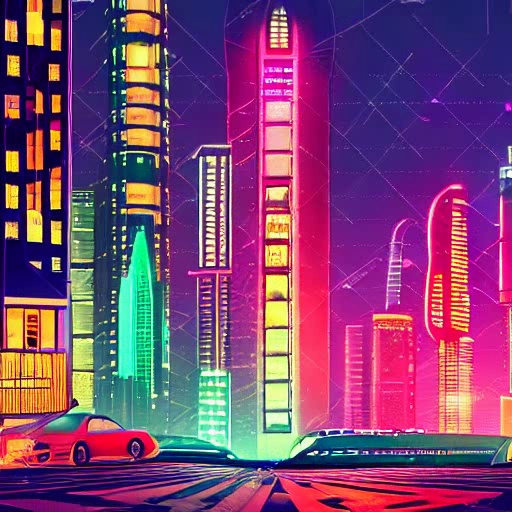

...

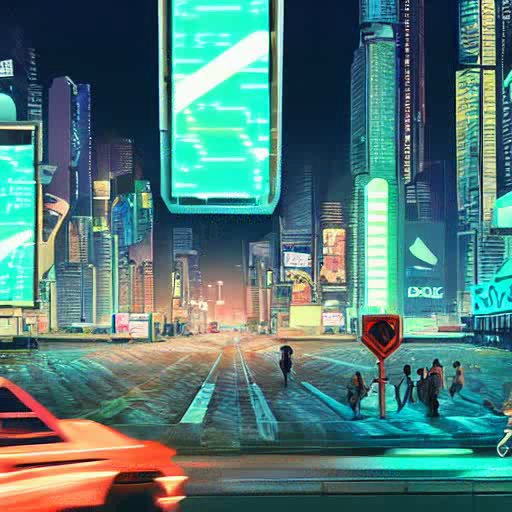

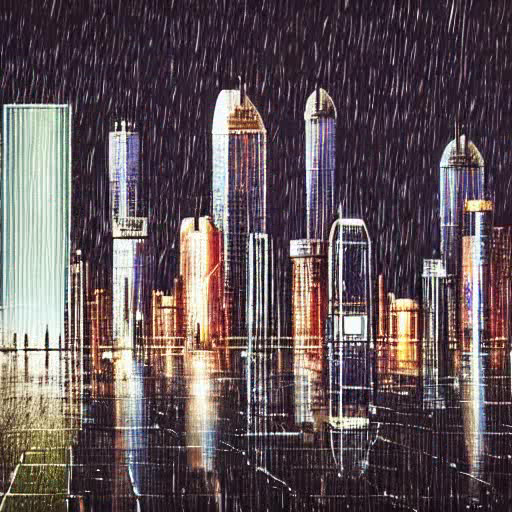

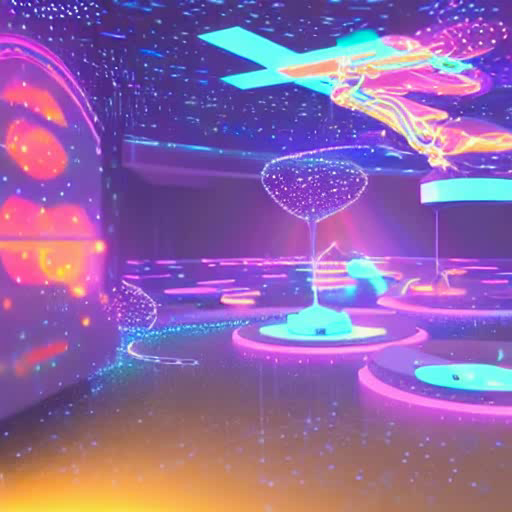

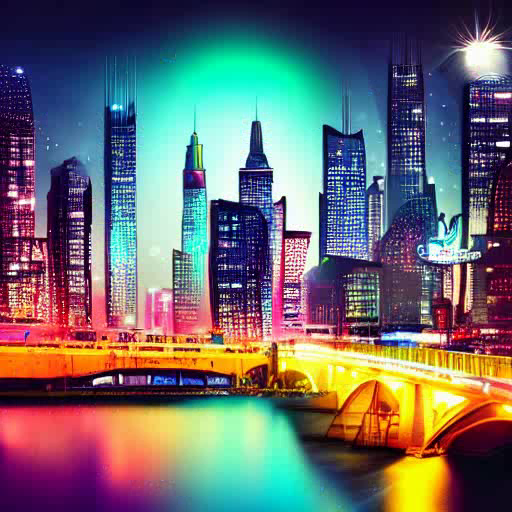

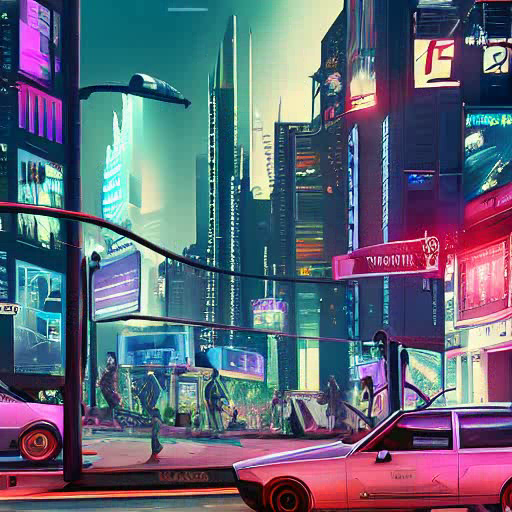

In [ ]:
from google.colab.patches import cv2_imshow
cap = cv2.VideoCapture("generated_video.avi")
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    cv2_imshow(frame)  # Display frame in Colab

    if cv2.waitKey(25) & 0xFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()
